 **Object Detection using MASK-RCNN without using MASK Prediction**

**Mount google drive**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Install required dependencies**

In [2]:
!pip install -U scikit-image==0.16.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


**Import Libraries**

In [3]:
import os
import sys
sys.path.append("/content/drive/MyDrive/Mask RCNN")  # To find local version of the library
import json
import datetime
import numpy as np
import mrcnn.utils as utils
import skimage.io
from imgaug import augmenters as iaa
print("Numpy version: ",np.__version__) # 1.19.2
import skimage.draw
import tensorflow as tf
print("TensorFlow version: ",tf.__version__) #2.5.0
import random
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import skimage
from keras.backend import manual_variable_initialization 
import cv2
import random

Numpy version:  1.21.6
TensorFlow version:  2.9.2


In [4]:
from os import listdir
from xml.etree import ElementTree
from numpy import zeros
from numpy import asarray
from mrcnn.utils import Dataset
from matplotlib import pyplot
from mrcnn.visualize import display_instances
from mrcnn.utils import extract_bboxes
from mrcnn.utils import download_trained_weights
from mrcnn.config import Config
from mrcnn.model import MaskRCNN
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
from mrcnn.utils import Dataset
from mrcnn.utils import compute_ap
from mrcnn.model import load_image_gt
from mrcnn.model import mold_image



**Class for reading data and annotations**

In [5]:
# class that defines and loads the kangaroo dataset
class FruitsDataset(Dataset):
    # load the dataset definitions
    def load_dataset(self,dataset_dir,is_train=True):
      """
      loads the dataset given the dataset directory 
      args:
      * dataset_dir: str or path, directory path containing the dataset
      * is_train: boolean, specifying if the directory is of train or test data
      """
      # define classes
      self.add_class("dataset",1,"apple")
      self.add_class("dataset",2,"banana")
      self.add_class("dataset",3,"orange")
      # define data locations
      for i,filename in enumerate(os.listdir(dataset_dir)):
        s = filename.split(".")
        if s[-1]=="jpg":
          imagepath = os.path.join(dataset_dir,filename)
          annotpath = os.path.join(dataset_dir,s[0]+".xml")
          boxes ,w ,h = self.extract_boxes(annotpath)
          if w and h :
            self.add_image("dataset",image_id=i,path=imagepath,annotation=annotpath)

	# extract bounding boxes from an annotation file
    def extract_boxes(self, filename):
		# load and parse the file
        tree = ElementTree.parse(filename)
		# get the root of the document
        root = tree.getroot()
		# extract each bounding box
        boxes = list()
        for box in root.findall('.//object'):
            name = box.find('name').text   #Add label name to the box list
            xmin = int(box.find('./bndbox/xmin').text)
            ymin = int(box.find('./bndbox/ymin').text)
            xmax = int(box.find('./bndbox/xmax').text)
            ymax = int(box.find('./bndbox/ymax').text)
            coors = [xmin, ymin, xmax, ymax, name]
            boxes.append(coors)
		# extract image dimensions
        width = int(root.find('.//size/width').text)
        height = int(root.find('.//size/height').text)
        return boxes, width, height

	# load the masks for an image
    def load_mask(self, image_id):
		# get details of image
        info = self.image_info[image_id]
		# define box file location
        path = info['annotation']
        #return info, path
        
        
		# load XML
        boxes, w, h = self.extract_boxes(path)
		# create one array for all masks, each on a different channel
        masks = zeros([h, w, len(boxes)], dtype='uint8')
		# create masks
        class_ids = list()
        for i in range(len(boxes)):
            box = boxes[i]
            row_s, row_e = box[1], box[3]
            col_s, col_e = box[0], box[2]
            
            
            # box[4] will have the name of the class 
            if (box[4] == 'apple'):
                masks[row_s:row_e, col_s:col_e, i] = 1
                class_ids.append(self.class_names.index('apple'))
            elif(box[4] == 'banana'):
                masks[row_s:row_e, col_s:col_e, i] = 2
                class_ids.append(self.class_names.index('banana')) 
            elif(box[4] == 'orange'):
                masks[row_s:row_e, col_s:col_e, i] = 3
                class_ids.append(self.class_names.index('orange'))
          
        return masks, asarray(class_ids, dtype='int32')
        

	# load an image reference
    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path']


**Read train and test data**

In [6]:
# train set
#dataset_dir='datasets/renamed_to_numbers'

train_set = FruitsDataset()
train_set.load_dataset("/content/drive/MyDrive/fruits/train", is_train=True)
train_set.prepare()
print('Train: %d' % len(train_set.image_ids))

# test/val set
test_set = FruitsDataset()
test_set.load_dataset("/content/drive/MyDrive/fruits/test", is_train=False)
test_set.prepare()
print('Test: %d' % len(test_set.image_ids))


Train: 207
Test: 56


**Configuration of Fruit class**

In [ ]:
class FruitsConfig(Config):
	# define the name of the configuration
	NAME = "fruits_cfg"
	# number of classes (background + 3 fruits)
	NUM_CLASSES = 1 + 3
	# number of training steps per epoch
	STEPS_PER_EPOCH = 100
    
    
  
# prepare config
config = FruitsConfig()
config.display()



Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                16
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

**Model training**

In [ ]:

ROOT_DIR = os.path.abspath("/content/drive/MyDrive")
# Directory to save logs and trained model
DEFAULT_LOGS_DIR = os.path.join(ROOT_DIR, "logs")

###############
augmentation = iaa.SomeOf((0, 2), [
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        iaa.OneOf([iaa.Affine(rotate=90),
                   iaa.Affine(rotate=180),
                   iaa.Affine(rotate=270)]),
        iaa.Multiply((0.8, 1.5)),
        iaa.GaussianBlur(sigma=(0.0, 5.0))
    ])
# define the model
model = MaskRCNN(mode='training', model_dir="logs", config=config)
# load weights (mscoco) and exclude the output layers
model.load_weights("/content/drive/MyDrive/mask_rcnn_coco.h5", by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",  "mrcnn_bbox", "mrcnn_mask"])


# train weights (output layers or 'heads')
model.train(train_set, test_set, learning_rate=config.LEARNING_RATE, epochs=10, augmentation=augmentation,layers='all')
#########################################

#INFERENCE

###################################################



Starting at epoch 0. LR=0.001

Checkpoint Path: logs/fruits_cfg20221221T1405/mask_rcnn_fruits_cfg_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2b         (Conv2D)
bn3a_branch2b          (

/usr/local/lib/python3.8/dist-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("training/SGD/gradients/gradients/roi_align_classifier/concat_grad/sub:0", shape=(None,), dtype=int32), values=Tensor("training/SGD/gradients/gradients/roi_align_classifier/concat_grad/GatherV2_2:0", shape=(None, 7, 7, 256), dtype=float32), dense_shape=Tensor("training/SGD/gradients/gradients/roi_align_classifier/concat_grad/Shape:0", shape=(4,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("training/SGD/gradients/gradients/roi_align_classifier/concat_grad/sub_1:0", shape=(None,), dtype=int32), values=Tensor("training/SGD/gradients/gradients/roi_align_classifier/concat_grad/GatherV2_5:0", shape=(Non

100/100 [==============================] - ETA: 0s - batch: 49.5000 - size: 2.0000 - loss: 3.1790 - rpn_class_loss: 0.1700 - rpn_bbox_loss: 1.0223 - mrcnn_class_loss: 0.6612 - mrcnn_bbox_loss: 0.7395 - mrcnn_mask_loss: 0.5860

/usr/local/lib/python3.8/dist-packages/keras/engine/training_v1.py:2045: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates


100/100 [==============================] - 275s 2s/step - batch: 49.5000 - size: 2.0000 - loss: 3.1790 - rpn_class_loss: 0.1700 - rpn_bbox_loss: 1.0223 - mrcnn_class_loss: 0.6612 - mrcnn_bbox_loss: 0.7395 - mrcnn_mask_loss: 0.5860 - val_loss: 2.3476 - val_rpn_class_loss: 0.0284 - val_rpn_bbox_loss: 1.0129 - val_mrcnn_class_loss: 0.2297 - val_mrcnn_bbox_loss: 0.5732 - val_mrcnn_mask_loss: 0.5035
Epoch 2/10
100/100 [==============================] - 171s 2s/step - batch: 49.5000 - size: 2.0000 - loss: 1.9416 - rpn_class_loss: 0.0242 - rpn_bbox_loss: 0.5926 - mrcnn_class_loss: 0.2829 - mrcnn_bbox_loss: 0.5256 - mrcnn_mask_loss: 0.5163 - val_loss: 2.1434 - val_rpn_class_loss: 0.0241 - val_rpn_bbox_loss: 0.8888 - val_mrcnn_class_loss: 0.3134 - val_mrcnn_bbox_loss: 0.4890 - val_mrcnn_mask_loss: 0.4282
Epoch 3/10
100/100 [==============================] - 170s 2s/step - batch: 49.5000 - size: 2.0000 - loss: 1.7372 - rpn_class_loss: 0.0203 - rpn_bbox_loss: 0.5946 - mrcnn_class_loss: 0.2508 - m

In [7]:

# define the prediction configuration
class PredictionConfig(Config):
  NAME = "fruit_cfg"
  NUM_CLASSES = 4
  GPU_COUNT = 1
  USE_MINI_MASK = False
  IMAGES_PER_GPU = 1
  


# create config
cfg = PredictionConfig()
# define the model

manual_variable_initialization(True)
model = MaskRCNN(mode='inference', model_dir='logs', config=cfg)
# Create model object in inference mode.
#model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
# model.load_weights(COCO_MODEL_PATH, by_name=True)

tf.keras.Model.load_weights(model.keras_model, '/content/drive/MyDrive/logs/fruit_cfg20221221T0846/mask_rcnn_fruit_cfg_0010.h5', by_name=True)

Instructions for updating:
Use fn_output_signature instead


In [8]:
def evaluation_model():
  import tensorflow.compat.v1 as tf

  manual_variable_initialization(True)
  model = MaskRCNN(mode='inference', model_dir='logs', config=cfg)
  #model = MaskRCNN(mode = 'inference',model_dir='./',config=cfg)
  
  tf.keras.Model.load_weights(model.keras_model, '/content/drive/MyDrive/logs/fruit_cfg20221221T0846/mask_rcnn_fruit_cfg_0010.h5', by_name=True)
  return model 

In [9]:
model = evaluation_model()

In [10]:
def plot_predictions (dataset,model,class_names,cfg,n_images=6):
  plt.figure(figsize=(15,15))
  for i in range(n_images):
    image = dataset.load_image(i)
    mask,_ = dataset.load_mask(i)
    scaled_image = mold_image(image,cfg)
    sample = np.expand_dims(scaled_image,0)
    yhat = model.detect(sample,verbose=0)[0]
    plt.subplot(n_images,2,2*i+1)
    plt.imshow(image)
    plt.title("actual")
    plt.axis(False)
    plt.grid(False)
  
    for j in range(mask.shape[2]):
      plt.imshow(mask[:,:,j],cmap="gray",alpha=0.3)
    plt.subplot(n_images,2,2*i+2)
    plt.title("prediction")
    plt.axis(False)
    plt.grid(False)
  
    for box,class_id in zip(yhat["rois"],yhat["class_ids"]):
      ymin,xmin,ymax,xmax = box
      width , height = xmax - xmin , ymax - ymin
      image = cv2.rectangle(image,(xmin,ymax),(xmax,ymin),(255,12,100),4)
      plt.text(xmin,ymax,class_names[class_id])
    plt.imshow(image)
    plt.grid(False)
  plt.tight_layout()
  plt.show()

In [11]:
CLASS_NAMES = ["orange","apple","banana"]

/usr/local/lib/python3.8/dist-packages/keras/engine/training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


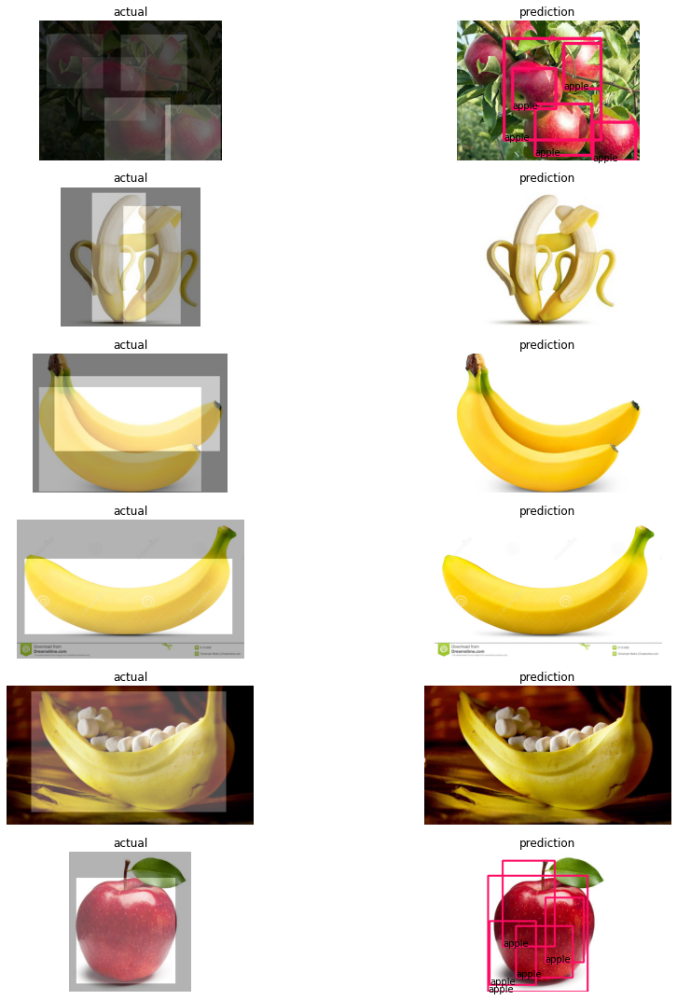

In [12]:
plot_predictions(test_set,model,CLASS_NAMES,cfg,n_images=6)

/usr/local/lib/python3.8/dist-packages/keras/engine/training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


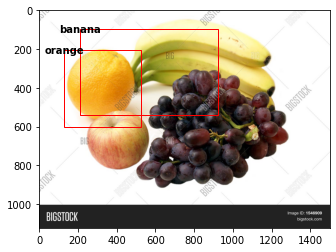

In [13]:
fruit_img = skimage.io.imread("/content/drive/MyDrive/fruits/test/mixed_23.jpg")
detected = model.detect([fruit_img])[0] 


pyplot.imshow(fruit_img)
ax = pyplot.gca()
class_names = ['apple', 'banana', 'orange']
class_id_counter=1
for box in detected['rois']:
    #print(box)
#get coordinates
    detected_class_id = detected['class_ids'][class_id_counter-1]
    y1, x1, y2, x2 = box
    #calculate width and height of the box
    width, height = x2 - x1, y2 - y1
    #create the shape
    ax.annotate(class_names[detected_class_id-1], (x1, y1), color='black', weight='bold', fontsize=10, ha='center', va='center')
    rect = Rectangle((x1, y1), width, height, fill=False, color='red')
#draw the box
    ax.add_patch(rect)
    class_id_counter+=1
#show the figure
pyplot.show()

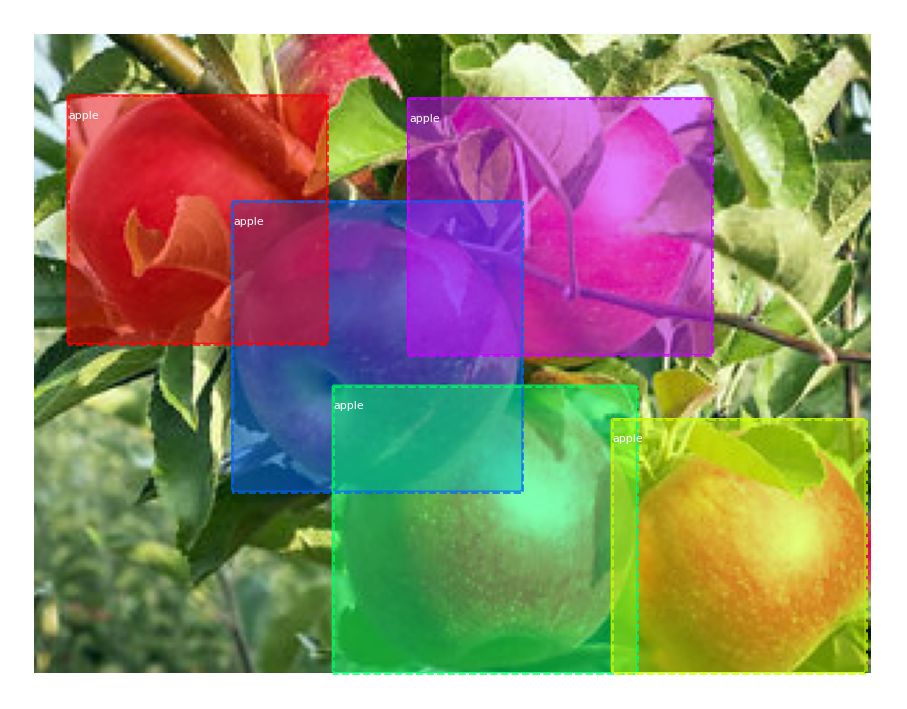

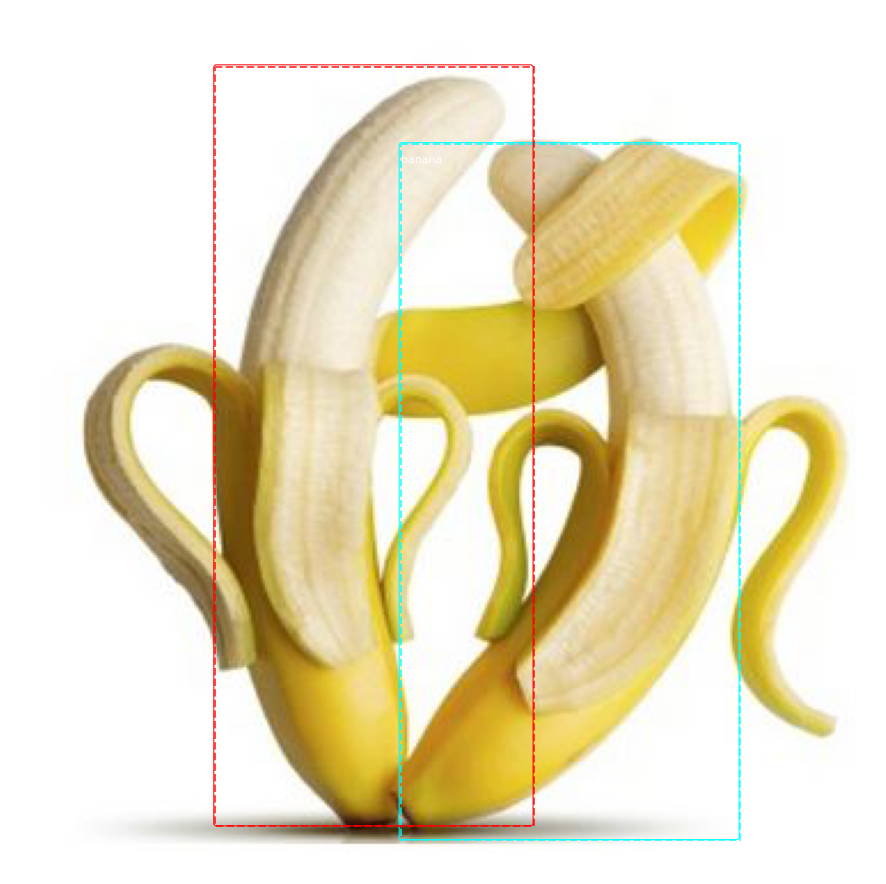

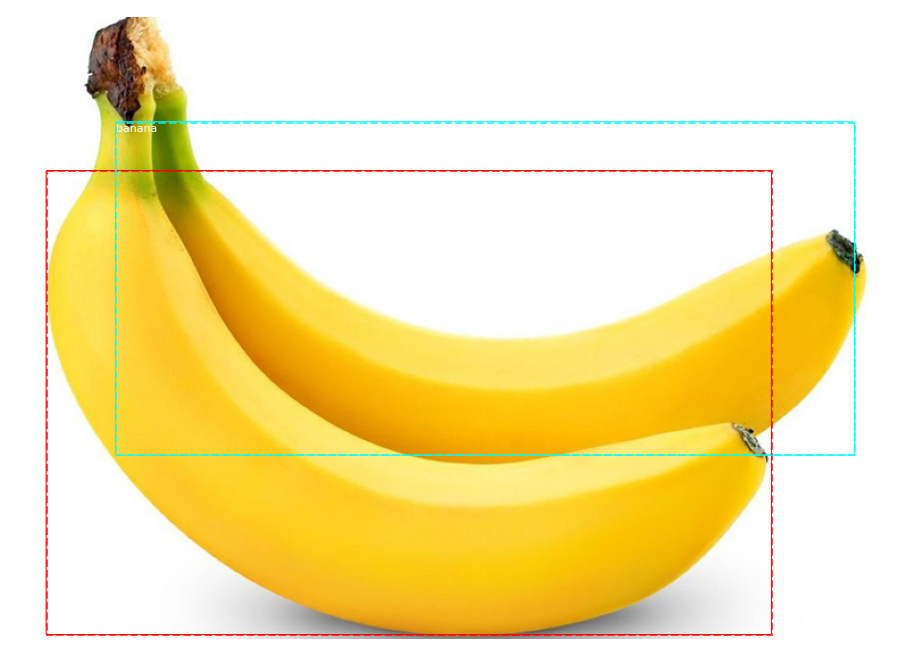

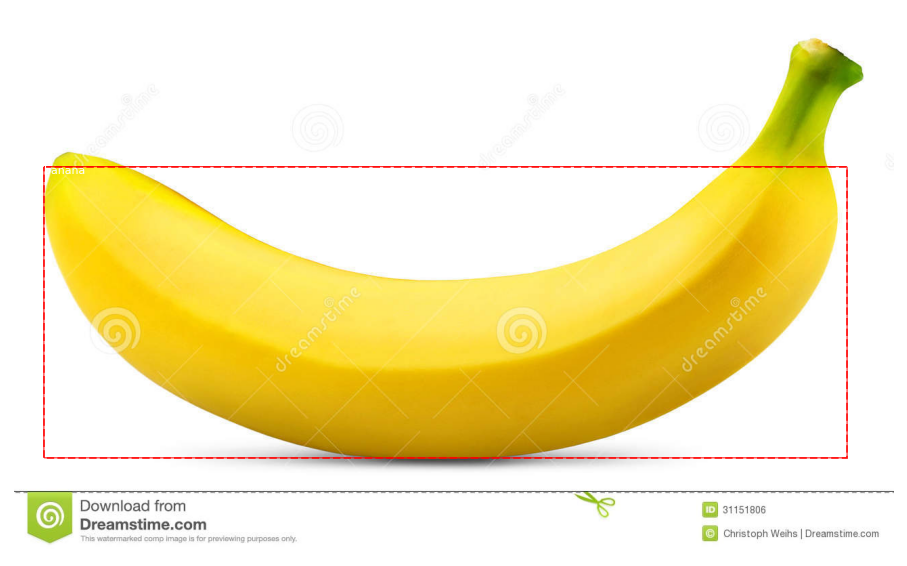

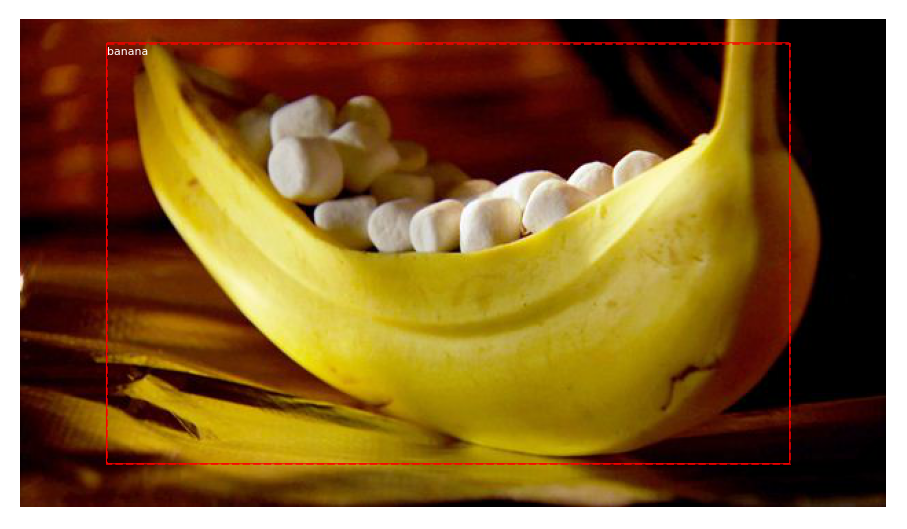

...

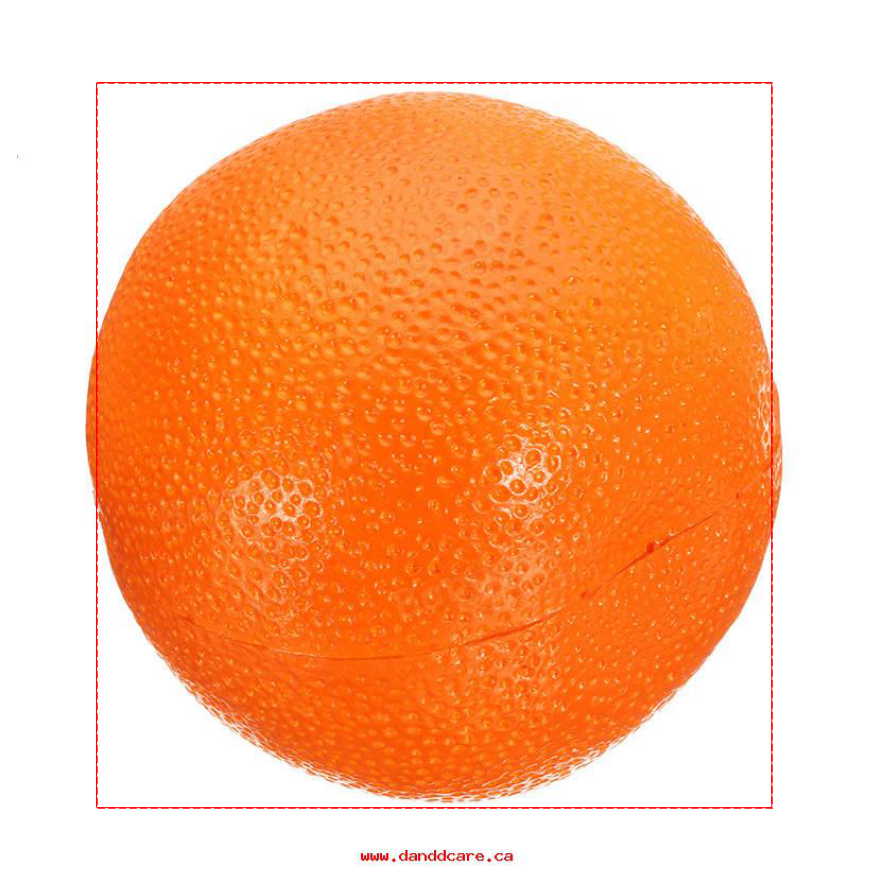

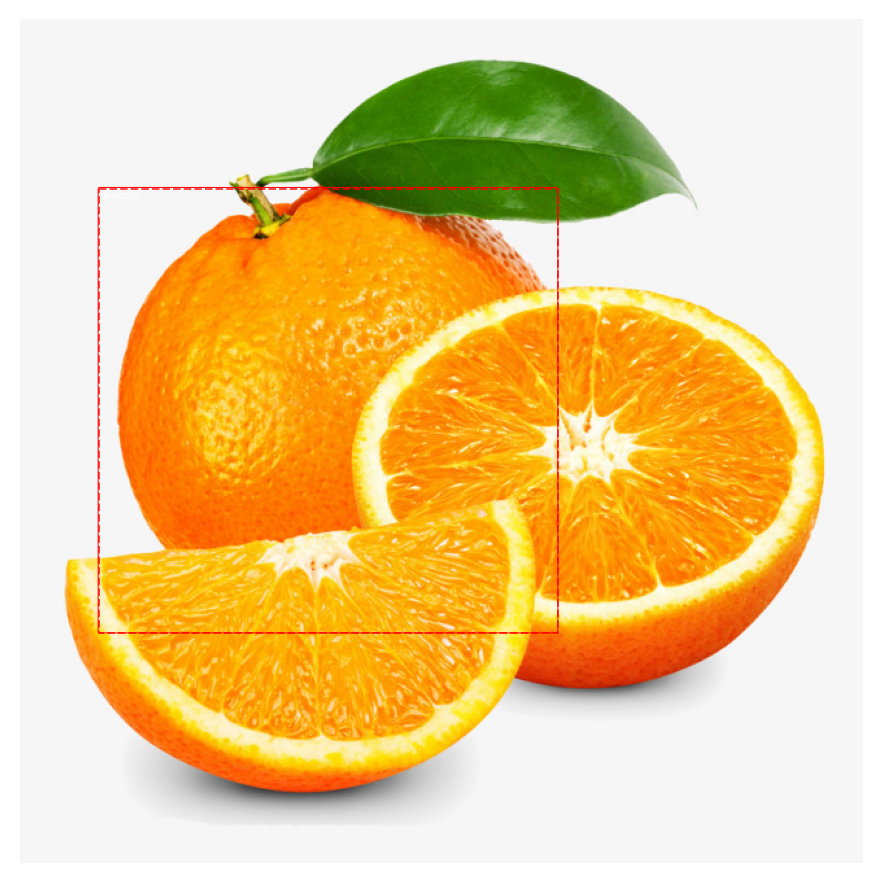

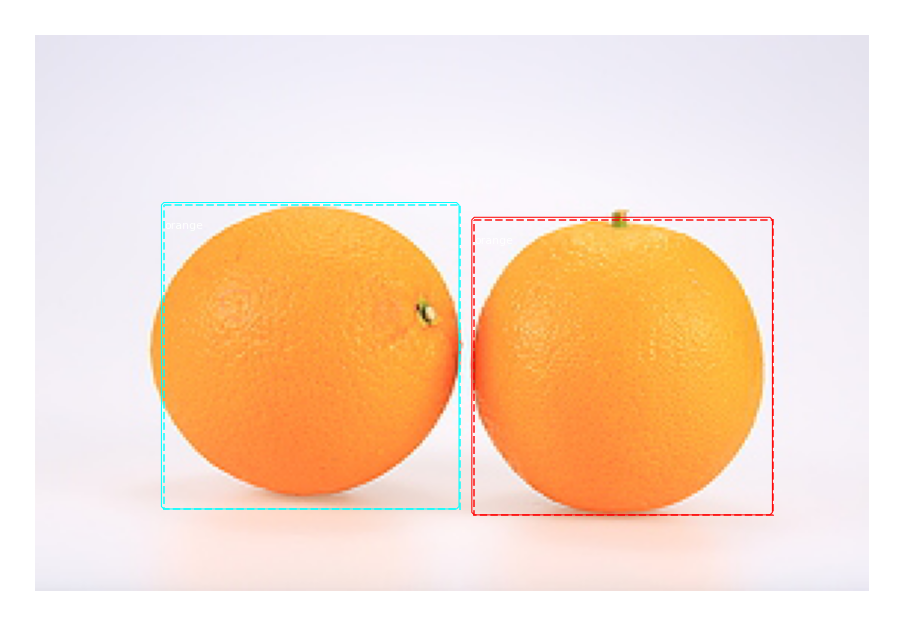

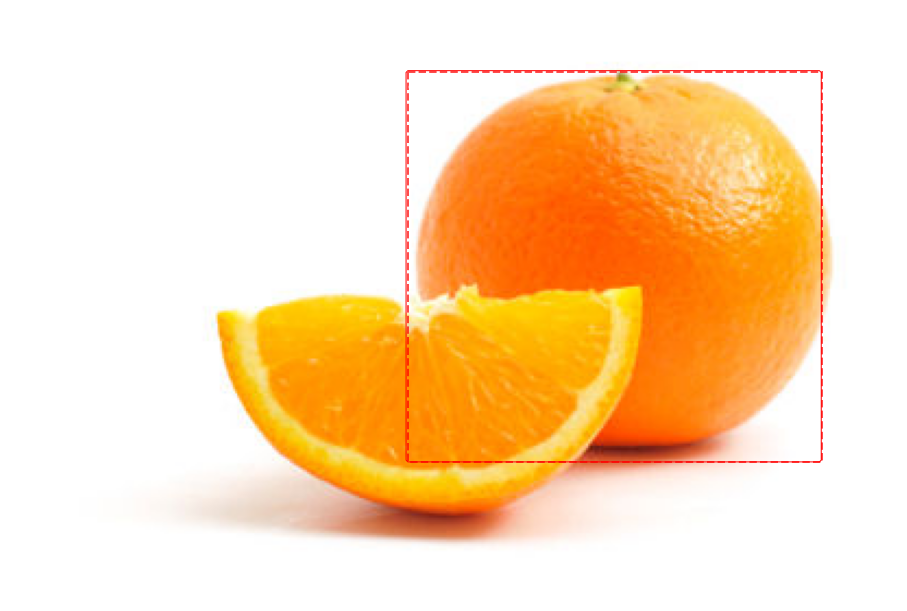

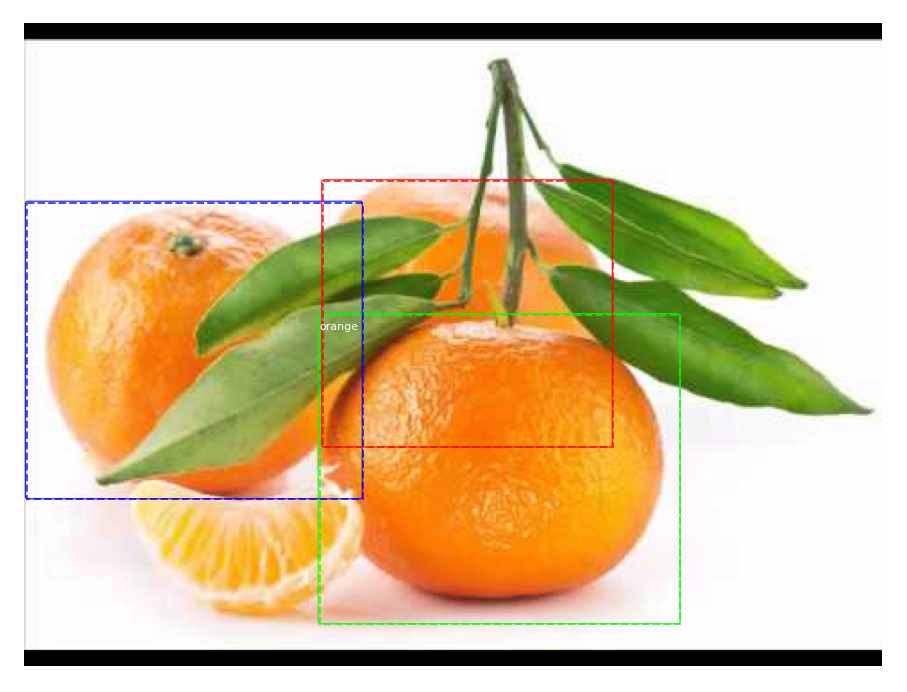

In [19]:
#num=random.randint(0, len(train_set.image_ids))
# define image id
for i in range(56):
  image_id = i
  # load the image
  image = test_set.load_image(image_id)
  # load the masks and the class ids
  mask, class_ids = test_set.load_mask(image_id)
  # extract bounding boxes from the masks
  bbox = extract_bboxes(mask)
  # display image with masks and bounding boxes
  display_instances(image, bbox, mask, class_ids, test_set.class_names)

In [ ]:
def evaluate_model (dataset,model,cfg):
  """
  evaluates the model with mAP metrics 
  args:
  * dataset: mrcnn.utils.Dataset instance
  * model: mrcnn.model.MaskRCNN instance
  * cfg: mrcnn.utils.Config instance
  """
  APS = list ()
  for image_id in dataset.image_ids :
    image, image_meta,gt_class_id,gt_bbox,gt_mask = load_image_gt(dataset,cfg,image_id)
    scaled_image = mold_image (image,cfg)
    sample = np.expand_dims(scaled_image,0)
    yhat = model.detect(sample,verbose=0)
    r = yhat [0]
    AP ,_,_,_= compute_ap(gt_bbox,gt_class_id,gt_mask,r["rois"],r["class_ids"],r["scores"],r["masks"])
    APS.append(AP)
  mAP=sum(APS)/len(APS)
  return mAP


In [ ]:
train_mAP = evaluate_model(train_set, model, cfg)
print("Train mAP: %.3f" % train_mAP)
test_mAP = evaluate_model(test_set, model, cfg)
print("Test mAP: %.3f" % test_mAP)

Train mAP: 0.247
Test mAP: 0.216


In [ ]:
def loss_visualize(epoch, tra_loss, val_loss):
    plt.style.use("ggplot")
    plt.figure()
    plt.subplot(1, 1, 1)
    plt.title("Epoch_Loss")
    plt.plot(epoch, tra_loss, label='train_loss', color='r', linestyle='-', marker='o')
    plt.plot(epoch, val_loss, label='val_loss', linestyle='-', color='b', marker='^')
    plt.legend()
    plt.xlabel('epoch')
    plt.ylabel('loss')
   # plt.savefig(os.path.join(RESULT_DIR, 'loss.jpg'))
    plt.show()

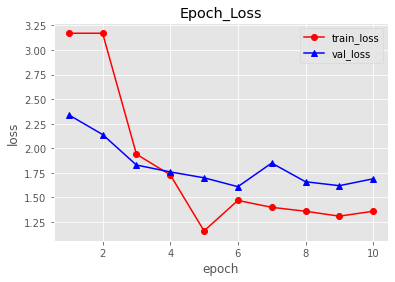

In [ ]:
tr_loss = [3.17, 3.17, 1.94, 1.73, 1.16, 1.47, 1.40, 1.36, 1.31, 1.36]
vl_loss = [2.34, 2.14, 1.83, 1.76, 1.70, 1.61, 1.85, 1.66, 1.62,1.69]
epoch = [1,2,3,4,5,6,7,8,9,10]
loss_visualize(epoch, tr_loss, vl_loss)